### Imports

In [5]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [6]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [7]:
from sklearn.preprocessing import Normalizer

In [8]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

### Setup

In [9]:
fig_dir = '../v3-fig/fig-cgis/'

In [10]:
cgi_csv = '../data/v3/institutions_data_prepped.csv'

In [11]:
cgi_df = pd.read_csv(cgi_csv)

In [12]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,mechanisms_include_hered,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_

Note: CGI -> CGI *mechanisms*

In [13]:
cgi_only_df = cgi_df[cgi_df['CGI'].notna()]

In [14]:
cgi_only_df.head()

,Institution_Name,Community_Name,Mechanism,Notes,Time span,Geography,Size,Source,Heterogeneity,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,mechanisms_include_hered,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_

In [15]:
cgi_mechanisms_list = [x for x in cgi_only_df.columns if 'cgis_include_' in x]
cgi_mechanisms_list

['decision_making_cgis_include_secret_ballot',
 'decision_making_cgis_include_consensus',
 'decision_making_cgis_include_consultation',
 'enforcement_cgis_include_criticism_mocking_joking',
 'decision_making_cgis_include_board_committee',
 'decision_making_cgis_include_group_voting',
 'decision_making_cgis_include_temporary_position_of_power_term_limits',
 'decision_making_cgis_include_gathering',
 'enforcement_cgis_include_arbitration',
 'decision_making_cgis_include_representation',
 'access_cgis_include_election',
 'decision_making_cgis_include_unanimity',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_screening_process',
 'decision_making_cgis_include_ratification_acclamation_only',
 'decision_making_cgis_include_assembly_central',
 'decision_making_cgis_include_turnover_rotation',
 'access_cgis_include_female_participation',
 'enforcement_cgis_include_exit',
 'enforcement_cgis_include_suspension_expulsion_ostracism_proscription',
 'decision_making_cgis_

In [16]:
cgi_mechanisms_df = cgi_only_df[cgi_mechanisms_list]

In [17]:
cgi_mechanisms_df

,decision_making_cgis_include_secret_ballot,decision_making_cgis_include_consensus,decision_making_cgis_include_consultation,enforcement_cgis_include_criticism_mocking_joking,decision_making_cgis_include_board_committee,decision_making_cgis_include_group_voting,decision_making_cgis_include_temporary_position_of_power_term_limits,decision_making_cgis_include_gathering,enforcement_cgis_include_arbitration,decision_making_cgis_include_representation,access_cgis_include_election,decision_making_cgis_include_unanimity,access_cgis_include_payment_for_occupying_office,access_cgis_include_screening_process,decision_making_cgis_include_ratification_acclamation_only,decision_making_cgis_include_assembly_central,decision_making_cgis_include_turnover_rotation,access_cgis_include_female_participation,enforcement_cgis_include_exit,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,decision_making_cgis_include_agenda_setting,enforcement_cgis_include_judicial_review,access_cgis_include_matriarchy,decision_making_cgis_include_council_central_,decision_making_cgis_include_assembly_elite,decision_making_cgis_include_assembly_local,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_frequent_and_or_regular_meetings,enforcement_cgis_include_litigation,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_oath,access_cgis_include_heredity,decision_making_cgis_include_veto,decision_making_cgis_include_delegation,decision_making_cgis_include_majority_voting,decision_making_cgis_include_public_meetings,access_cgis_include_co-optation,access_cgis_include_gerontocracy,decision_making_cgis_include_deliberation,decision_making_cgis_include_vote_by_show_of_hands,enforcement_cgis_include_tribunal_court_,access_cgis_include_life_appointment,access_cgis_include_property_requirement,decision_making_cgis_include_supermajority,decision_making_cgis_include_consent,decision_making_cgis_include_vote_by_proxy,decision_making_cgis_include_quorum,decision_making_cgis_include_council_local,access_cgis_include_blood_relations,decision_making_cgis_include_checks_and_balances,access_cgis_include_popularity_,access_cgis_include_meritocracy,decision_making_cgis_include_voting,enforcement_cgis_include_jury_judge,enforcement_cgis_include_scrutiny_of_officials,access_cgis_include_matrilineality,access_cgis_include_lottery_random_selection,enforcement_cgis_include_appeal,access_cgis_include_patronage_for_office,decision_making_cgis_include_remunerated_position,access_cgis_include_age_boundaries
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
10,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
17,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
19,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
25,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,1,1
26,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
27,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1


In [18]:
cgi_mechanisms_df.sum().sort_values(ascending=False)

decision_making_cgis_include_council_central_                           40
decision_making_cgis_include_assembly_central                           27
decision_making_cgis_include_council_local                              24
enforcement_cgis_include_tribunal_court_                                22
decision_making_cgis_include_frequent_and_or_regular_meetings           19
access_cgis_include_election                                            18
decision_making_cgis_include_deliberation                               16
decision_making_cgis_include_representation                             15
decision_making_cgis_include_assembly_local                             14
decision_making_cgis_include_consensus                                  14
access_cgis_include_age_boundaries                                      10
access_cgis_include_gerontocracy                                        10
decision_making_cgis_include_public_meetings                             9
decision_making_cgis_incl

In [23]:
cgi_mechanisms_df.sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_histogram.png')
plt.show()

TODO: 
  - comparative analysis b/n CGI mechanisms and non-CGI mechanisms

## By Mechanism category

In [24]:
access_cgis = [x for x in cgi_df.columns if 'access_cgis_' in x]

In [ ]:
cgi_df[access_cgis]

,access_cgis_include_election,access_cgis_include_payment_for_occupying_office,access_cgis_include_screening_process,access_cgis_include_female_participation,access_cgis_include_matriarchy,access_cgis_include_heredity,access_cgis_include_co-optation,access_cgis_include_gerontocracy,access_cgis_include_life_appointment,access_cgis_include_property_requirement,access_cgis_include_blood_relations,access_cgis_include_popularity_,access_cgis_include_meritocracy,access_cgis_include_matrilineality,access_cgis_include_lottery_random_selection,access_cgis_include_patronage_for_office,access_cgis_include_age_boundaries
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
cgi_df[access_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

<Axes: >

In [27]:
decision_making_cgis = [x for x in cgi_df.columns if 'decision_making_cgis_' in x]

In [28]:
cgi_df[decision_making_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

<Axes: >

In [29]:
enforcement_cgis = [x for x in cgi_df.columns if 'enforcement_cgis_' in x]

In [30]:
cgi_mechanisms_df[enforcement_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

<Axes: >

# CGI Mechanism Analysis 

In [31]:
# Select columns of interest

In [32]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'enforcement_mechanisms_include_graduated_sanctions',
 'access_mechanisms_include_dreaming',
 'decision_making_mechanisms_include_oath',
 'decision_making_mechanisms_include_board_committee',
 'enforcement_mechanisms_include_tribunal_court_',
 'enforcement_mechanisms_include_civil_disobedience',
 'decision_making_mechanisms_include_vote_by_show_of_hands',
 'decision_making_mechanisms_include_remunerated_position',
 'access_mechanisms_include_life_appointment',
 'decision_making_mechanisms_include_deliberation',
 'decision_making_mechanisms_include_assembly_local',
 'enforcement_mechanisms_include_mediation',
 'decision_making_mechanisms_include_leader_first_among_equals',
 'access_mechanisms_include_enfranchisement',
 'decision_making_mechanisms_include_autocratic_leader_chief_bound',
 'decision_making_mechanisms_inc

In [33]:
# Drop community mechanisms
mechanisms_list = [x for x in cgi_df.columns if x.startswith('mechanisms')]
mechanisms_list

['mechanisms_include_hered']

In [34]:
cgi_df.drop(columns=mechanisms_list, inplace=True)

In [35]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'enforcement_mechanisms_include_graduated_sanctions',
 'access_mechanisms_include_dreaming',
 'decision_making_mechanisms_include_oath',
 'decision_making_mechanisms_include_board_committee',
 'enforcement_mechanisms_include_tribunal_court_',
 'enforcement_mechanisms_include_civil_disobedience',
 'decision_making_mechanisms_include_vote_by_show_of_hands',
 'decision_making_mechanisms_include_remunerated_position',
 'access_mechanisms_include_life_appointment',
 'decision_making_mechanisms_include_deliberation',
 'decision_making_mechanisms_include_assembly_local',
 'enforcement_mechanisms_include_mediation',
 'decision_making_mechanisms_include_leader_first_among_equals',
 'access_mechanisms_include_enfranchisement',
 'decision_making_mechanisms_include_autocratic_leader_chief_bound',
 'decision_making_mechanisms_inc

## Normalized Correlation Matrix

In [36]:
data_plot = cgi_df.select_dtypes(include=[np.number])

In [37]:
data_plot.describe()

,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,enforce

In [38]:
data_plot.head()

,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,enforce

In [39]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,enforce

In [40]:
norm_corr.head()

,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,enforce

# Visualize and Sort CGI Correlations

In [41]:
plt.figure(figsize=(60, 60))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Triangle Correlation triangle_heatmap', fontdict={'fontsize':18}, pad=16);

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_triangle_correlations.png')
plt.show()

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_13218/4008594290.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))


In [42]:
cgis_list = [x for x in cgi_df.columns if 'cgis_' in x]
cgis_list

['decision_making_cgis_include_secret_ballot',
 'decision_making_cgis_include_consensus',
 'decision_making_cgis_include_consultation',
 'enforcement_cgis_include_criticism_mocking_joking',
 'decision_making_cgis_include_board_committee',
 'decision_making_cgis_include_group_voting',
 'decision_making_cgis_include_temporary_position_of_power_term_limits',
 'decision_making_cgis_include_gathering',
 'enforcement_cgis_include_arbitration',
 'decision_making_cgis_include_representation',
 'access_cgis_include_election',
 'decision_making_cgis_include_unanimity',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_screening_process',
 'decision_making_cgis_include_ratification_acclamation_only',
 'decision_making_cgis_include_assembly_central',
 'decision_making_cgis_include_turnover_rotation',
 'access_cgis_include_female_participation',
 'enforcement_cgis_include_exit',
 'enforcement_cgis_include_suspension_expulsion_ostracism_proscription',
 'decision_making_cgis_

In [43]:
cgis_df = norm_corr[cgis_list]

In [44]:
cgis_df

,decision_making_cgis_include_secret_ballot,decision_making_cgis_include_consensus,decision_making_cgis_include_consultation,enforcement_cgis_include_criticism_mocking_joking,decision_making_cgis_include_board_committee,decision_making_cgis_include_group_voting,decision_making_cgis_include_temporary_position_of_power_term_limits,decision_making_cgis_include_gathering,enforcement_cgis_include_arbitration,decision_making_cgis_include_representation,access_cgis_include_election,decision_making_cgis_include_unanimity,access_cgis_include_payment_for_occupying_office,access_cgis_include_screening_process,decision_making_cgis_include_ratification_acclamation_only,decision_making_cgis_include_assembly_central,decision_making_cgis_include_turnover_rotation,access_cgis_include_female_participation,enforcement_cgis_include_exit,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,decision_making_cgis_include_agenda_setting,enforcement_cgis_include_judicial_review,access_cgis_include_matriarchy,decision_making_cgis_include_council_central_,decision_making_cgis_include_assembly_elite,decision_making_cgis_include_assembly_local,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_frequent_and_or_regular_meetings,enforcement_cgis_include_litigation,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_oath,access_cgis_include_heredity,decision_making_cgis_include_veto,decision_making_cgis_include_delegation,decision_making_cgis_include_majority_voting,decision_making_cgis_include_public_meetings,access_cgis_include_co-optation,access_cgis_include_gerontocracy,decision_making_cgis_include_deliberation,decision_making_cgis_include_vote_by_show_of_hands,enforcement_cgis_include_tribunal_court_,access_cgis_include_life_appointment,access_cgis_include_property_requirement,decision_making_cgis_include_supermajority,decision_making_cgis_include_consent,decision_making_cgis_include_vote_by_proxy,decision_making_cgis_include_quorum,decision_making_cgis_include_council_local,access_cgis_include_blood_relations,decision_making_cgis_include_checks_and_balances,access_cgis_include_popularity_,access_cgis_include_meritocracy,decision_making_cgis_include_voting,enforcement_cgis_include_jury_judge,enforcement_cgis_include_scrutiny_of_officials,access_cgis_include_matrilineality,access_cgis_include_lottery_random_selection,enforcement_cgis_include_appeal,access_cgis_include_patronage_for_office,decision_making_cgis_include_remunerated_position,access_cgis_include_age_boundaries
Time span: Start,-0.105772,-0.019387,-0.027587,0.048254,-0.102201,-0.077539,-0.142645,0.057408,0.047959,0.028010,-0.129224,0.039731,0.039604,-0.139149,-0.092349,-0.195704,-0.156048,0.043635,0.039448,-0.071209,-0.106605,-0.073150,-0.085305,-0.163888,0.000593,0.014612,0.030394,-0.045279,-0.084781,-0.121407,-0.084781,0.070162,0.047897,-0.087658,-0.110976,-0.094074,0.062160,0.040269,-0.043539,-0.105772,-0.054432,0.043602,-0.109979,0.055207,0.027429,0.062953,-0.077638,0.149123,0.029841,0.028840,0.046251,0.090398,-0.073356,-0.142947,-0.163346,0.030394,-0.176274,0.038738,0.046014,-0.143285,-0.243903
Time span: End,-0.087678,-0.005155,-0.002019,0.034770,-0.081227,-0.042224,-0.134933,0.078831,0.035050,0.027476,-0.080406,0.033969,0.061399,-0.102141,-0.042184,-0.118310,-0.127783,0.047757,0.040721,-0.079348,-0.083974,-0.074769,-0.086142,-0.105735,0.022049,0.006018,0.043407,-0.044438,-0.089905,-0.086445,-0.089905,0.066939,0.035108,-0.038630,-0.103839,-0.066021,0.053513,0.016639,-0.016802,-0.087678,-0.034889,0.038457,-0.060164,0.056150,0.052500,0.053048,-0.042473,0.129218,0.043492,0.043627,0.036537,0.086610,-0.054175,-0.141486,-0.134137,0.043407,-0.152205,0.041033,0.036728,-0.129596,-0.207662
enforcement_mechanisms_include_graduated_sanctions,-0.005103,-0.010200,-0.007760,-0.003268,-0.005304,-0.003268,-0.007836,-0.007284,-0.003268,-0.011076,-0.011917,-0.006489,-0.004599,-0.005677,-0.005949,-0.014096,-0.006955,0.285250,-0.003268,-0.003944,-0

In [45]:
query_cgis_df = cgis_df.transpose()

In [46]:
query_cgis_df.head()

,Time span: Start,Time span: End,enforcement_mechanisms_include_graduated_sanctions,access_mechanisms_include_dreaming,decision_making_mechanisms_include_oath,decision_making_mechanisms_include_board_committee,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_civil_disobedience,decision_making_mechanisms_include_vote_by_show_of_hands,decision_making_mechanisms_include_remunerated_position,access_mechanisms_include_life_appointment,decision_making_mechanisms_include_deliberation,decision_making_mechanisms_include_assembly_local,enforcement_mechanisms_include_mediation,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_enfranchisement,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_assembly_central,decision_making_mechanisms_include_alliance,access_mechanisms_include_heredity,access_mechanisms_include_election,decision_making_mechanisms_include_magistrate_official,decision_making_mechanisms_include_ratification_acclamation_only,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_veto,decision_making_mechanisms_include_unanimity,enforcement_mechanisms_include_criticism_mocking_joking,decision_making_mechanisms_include_agenda_setting,enforcement_mechanisms_include_fines,access_mechanisms_include_female_participation,enforcement_mechanisms_include_paying_damages_compensation,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_gathering,access_mechanisms_include_patronage_for_office,access_mechanisms_include_divine_right,access_mechanisms_include_matrilineality,decision_making_mechanisms_include_mandate,enforcement_mechanisms_include_destruction_of_property,enforcement_mechanisms_include_forced_labour,decision_making_mechanisms_include_quorum,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_power_fluidity,enforcement_mechanisms_include_arbitration,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_exit,decision_making_mechanisms_include_voting,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_autocratic_leader_unbound,decision_making_mechanisms_include_consensus,decision_making_mechanisms_include_council_local,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_majority_voting,access_mechanisms_include_open_political_unit,decision_making_mechanisms_include_checks_and_balances,decision_making_mechanisms_include_public_meetings,enforcement_mechanisms_include_self-help,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_president_consul_chief_executive,access_mechanisms_include_matriarchy,access_mechanisms_include_lottery_random_selection,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_vote_by_proxy,enforcement_mechanisms_include_police,decision_making_mechanisms_include_consultation,decision_making_mechanisms_include_assembly_elite,enforcement_mechanisms_include_monitoring,enforcement_mechanisms_include_corporal_punishment_violence_against_perpetrator,enforcement_mechanisms_include_negotiation,access_mechanisms_include_blood_relations,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_dual-sex_political_system,decision_making_mechanisms_include_representation,access_mechanisms_include_popularity_,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_rule_of_law,enforcement_mechanisms_include_seizing_of_property,decision_making_mechanisms_include_constitution,decision_making_mechanisms_include_temporary_position_of_power_term_limits,decision_making_mechanisms_include_turnover_rotation,enforce

## Time x Region x Size for CGIs

In [47]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [48]:
region_cols = [r for r in list(cgi_df) if 'Region: ' in r] 

In [49]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [50]:
list(cgi_df.columns)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Notes',
 'Time span',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'Time span: Start',
 'Time span: End',
 'enforcement_mechanisms_include_graduated_sanctions',
 'access_mechanisms_include_dreaming',
 'decision_making_mechanisms_include_oath',
 'decision_making_mechanisms_include_board_committee',
 'enforcement_mechanisms_include_tribunal_court_',
 'enforcement_mechanisms_include_civil_disobedience',
 'decision_making_mechanisms_include_vote_by_show_of_hands',
 'decision_making_mechanisms_include_remunerated_position',
 'access_mechanisms_include_life_appointment',
 'decision_making_mechanisms_include_deliberation',
 'decision_making_mechanisms_include_assembly_local',
 'enforcement_mechanisms_include_mediation',
 'decision_making_mechanisms_include_leader_first_among_equals',
 'access_mechanisms_include_enfranchisement',
 'decision_making_mechanisms_include_autocratic_leader_chief_bound',
 'decision_making_mechanisms_inc

## Time x CGIs

In [51]:
time_cgis = query_cgis_df[time_span_cols]
time_cgis

,Time span: Start,Time span: End,Time span: Duration
decision_making_cgis_include_secret_ballot,-0.105772,-0.087678,0.085744
decision_making_cgis_include_consensus,-0.019387,-0.005155,0.044906
decision_making_cgis_include_consultation,-0.027587,-0.002019,0.078118
enforcement_cgis_include_criticism_mocking_joking,0.048254,0.034770,-0.053102
decision_making_cgis_include_board_committee,-0.102201,-0.081227,0.092182
decision_making_cgis_include_group_voting,-0.077539,-0.042224,0.121823
decision_making_cgis_include_temporary_position_of_power_term_limits,-0.142645,-0.134933,0.071003
decision_making_cgis_include_gathering,0.057408,0.078831,0.037014
enforcement_cgis_include_arbitration,0.047959,0.035050,-0.051459
decision_making_cgis_include_representation,0.028010,0.027476,-0.011320


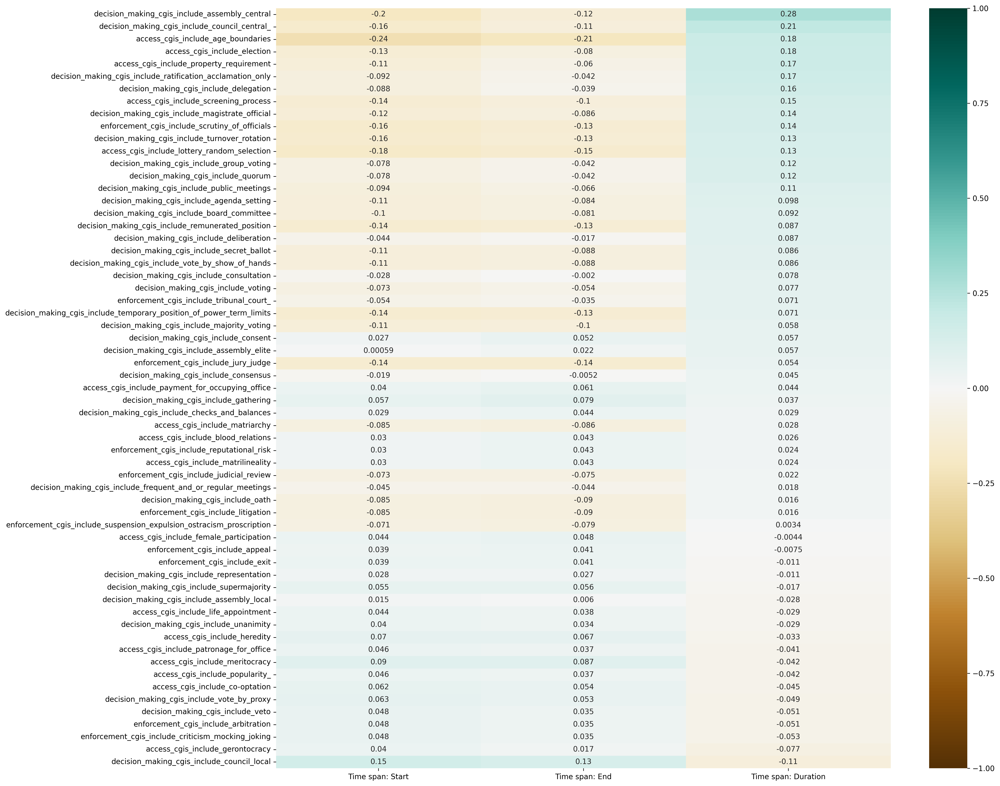

In [52]:
plt.figure(figsize=(20,15))

sns.heatmap(time_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_time.png')
plt.show()

### Time x CGIs: Access, Decision Making, Enforcement

In [53]:
access_cgis

['access_cgis_include_election',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_screening_process',
 'access_cgis_include_female_participation',
 'access_cgis_include_matriarchy',
 'access_cgis_include_heredity',
 'access_cgis_include_co-optation',
 'access_cgis_include_gerontocracy',
 'access_cgis_include_life_appointment',
 'access_cgis_include_property_requirement',
 'access_cgis_include_blood_relations',
 'access_cgis_include_popularity_',
 'access_cgis_include_meritocracy',
 'access_cgis_include_matrilineality',
 'access_cgis_include_lottery_random_selection',
 'access_cgis_include_patronage_for_office',
 'access_cgis_include_age_boundaries']

In [54]:
time_access_cgis = time_cgis.loc[access_cgis]

In [55]:
time_access_cgis

,Time span: Start,Time span: End,Time span: Duration
access_cgis_include_election,-0.129224,-0.080406,0.176190
access_cgis_include_payment_for_occupying_office,0.039604,0.061399,0.044299
access_cgis_include_screening_process,-0.139149,-0.102141,0.148112
access_cgis_include_female_participation,0.043635,0.047757,-0.004385
access_cgis_include_matriarchy,-0.085305,-0.086142,0.027891
access_cgis_include_heredity,0.070162,0.066939,-0.033397
access_cgis_include_co-optation,0.062160,0.053513,-0.045078
access_cgis_include_gerontocracy,0.040269,0.016639,-0.077415
access_cgis_include_life_appointment,0.043602,0.038457,-0.029159
access_cgis_include_property_requirement,-0.109979,-0.060164,0.172058


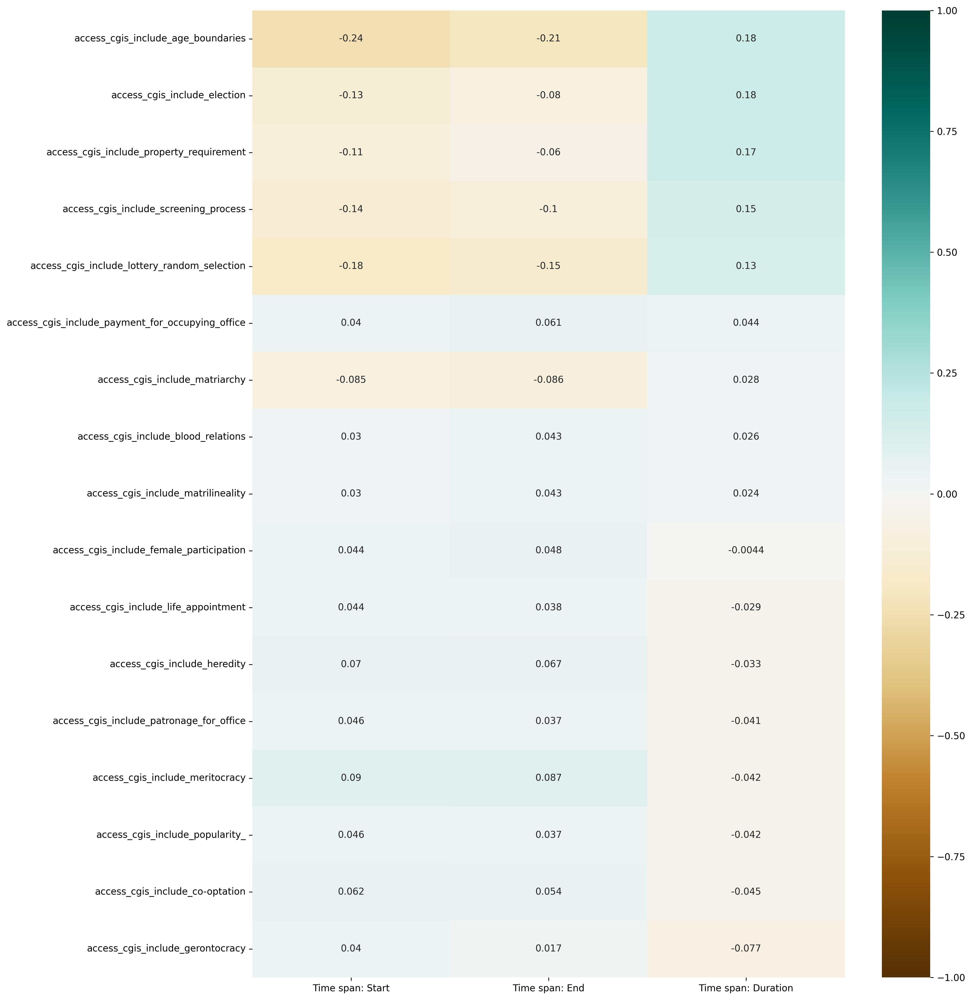

In [56]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_access_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_access_cgis.png')
plt.show()

In [57]:
time_decision_making_cgis = time_cgis.loc[decision_making_cgis]

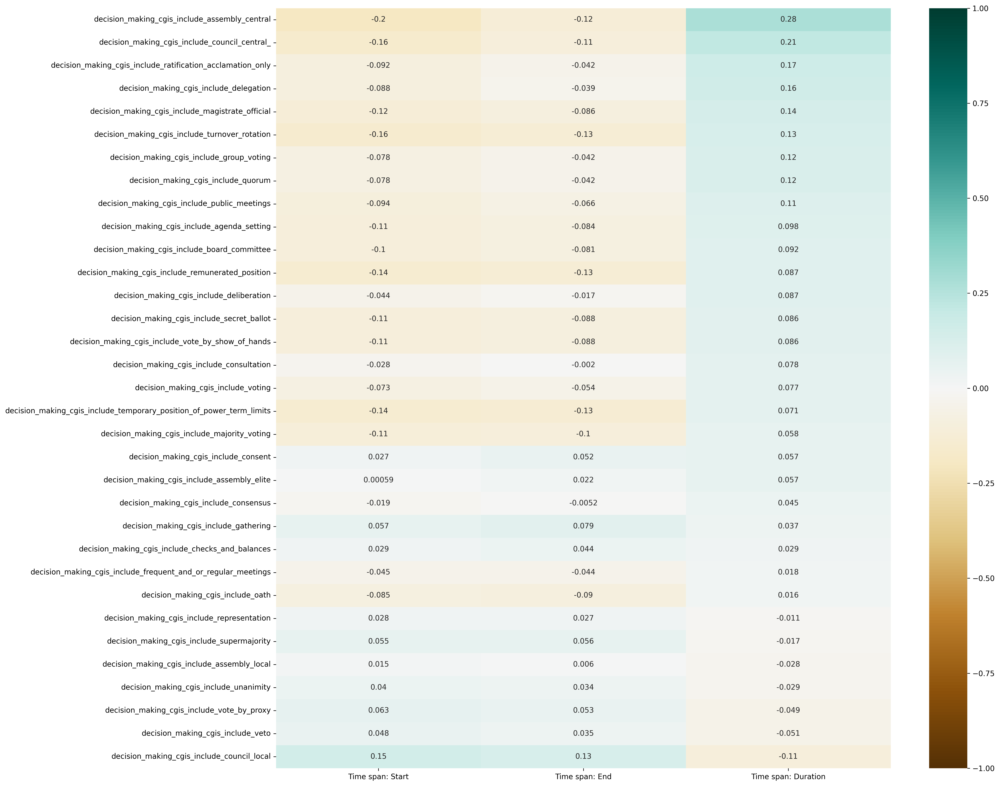

In [58]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_decision_making_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_decision_making_cgis.png')
plt.show()

In [59]:
time_enforcement_cgis = time_cgis.loc[enforcement_cgis]

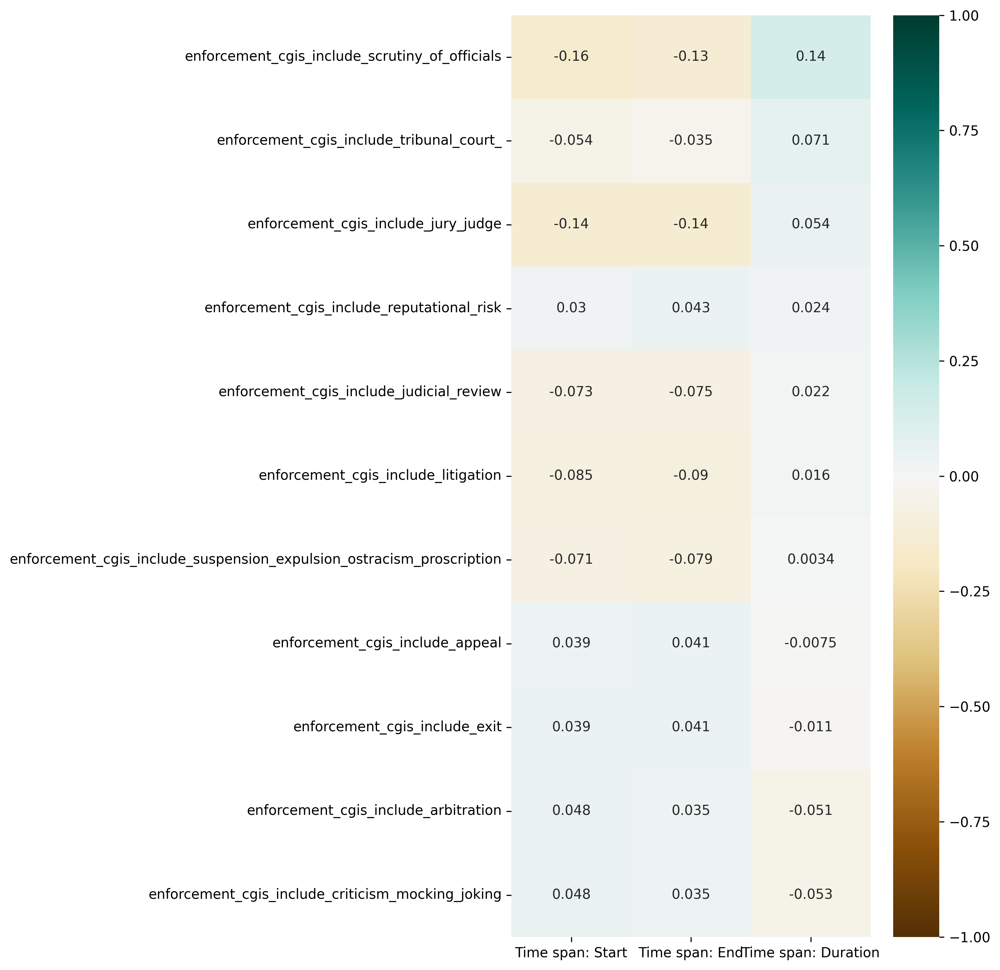

In [60]:
plt.figure(figsize=(10,10))

sns.heatmap(time_enforcement_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'time_enforcement_cgis.png')
plt.show()

## Region x CGIs

In [61]:
region_cgis = query_cgis_df[region_cols]
region_cgis

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
decision_making_cgis_include_secret_ballot,-0.027605,0.182431,-0.043158,-0.032049,-0.032955,0.020413,-0.007228,-0.008867
decision_making_cgis_include_consensus,-0.023553,0.103475,-0.012524,-0.064063,0.033228,0.026343,-0.014449,0.067740
decision_making_cgis_include_consultation,-0.041978,-0.069676,0.104357,0.175753,0.118793,-0.026982,-0.010992,-0.013484
enforcement_cgis_include_criticism_mocking_joking,-0.017679,-0.029344,0.074930,-0.020525,-0.021105,-0.011363,-0.004629,-0.005679
decision_making_cgis_include_board_committee,-0.028695,0.191365,-0.044862,-0.033314,-0.034256,-0.018444,-0.007514,-0.009217
decision_making_cgis_include_group_voting,-0.017679,0.120295,-0.027640,-0.020525,-0.021105,-0.011363,-0.004629,-0.005679
decision_making_cgis_include_temporary_position_of_power_term_limits,-0.042389,0.274323,-0.066273,-0.049213,-0.050606,-0.027246,-0.011100,-0.013617
decision_making_cgis_include_gathering,-0.019380,-0.065404,0.012833,0.212331,0.001477,-0.025328,0.182478,-0.012658
enforcement_cgis_include_arbitration,-0.017679,-0.029344,0.069063,-0.020525,-0.021105,-0.011363,-0.004629,-0.005679
decision_making_cgis_include_representation,0.016400,0.036651,0.037034,-0.069561,-0.004245,-0.038512,-0.015689,-0.019247


In [62]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_cgis = region_cgis[cols_to_move + [col for col in region_cgis.columns if col not in cols_to_move ]]

In [63]:
plt.figure(figsize=(20,15))

sns.heatmap(region_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_region.png')
plt.show()

### Region x CGIs: Access, Decision Making, Enforcement

In [64]:
region_access_cgis = region_cgis.loc[access_cgis]

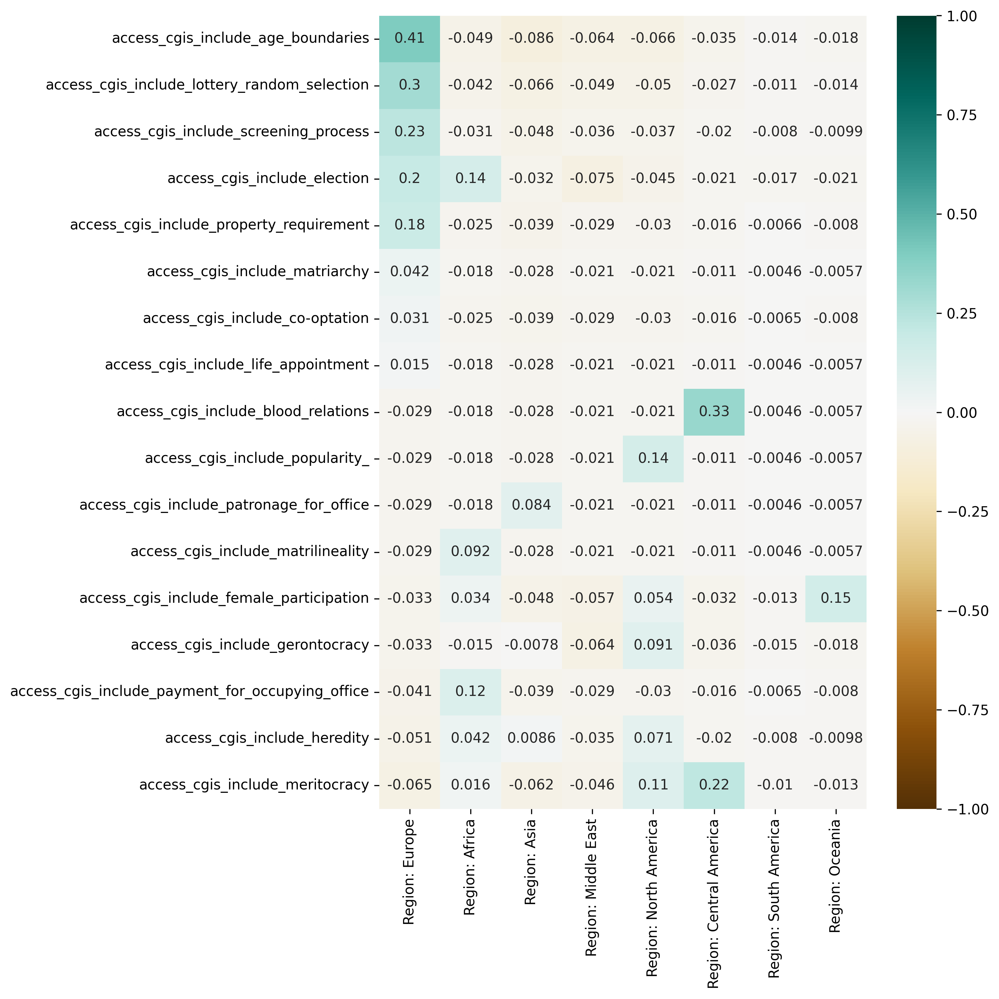

In [65]:
plt.figure(figsize=(10,10))

sns.heatmap(region_access_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_access_cgis.png')
plt.show()

In [66]:
region_decision_making_cgis = region_cgis.loc[decision_making_cgis]

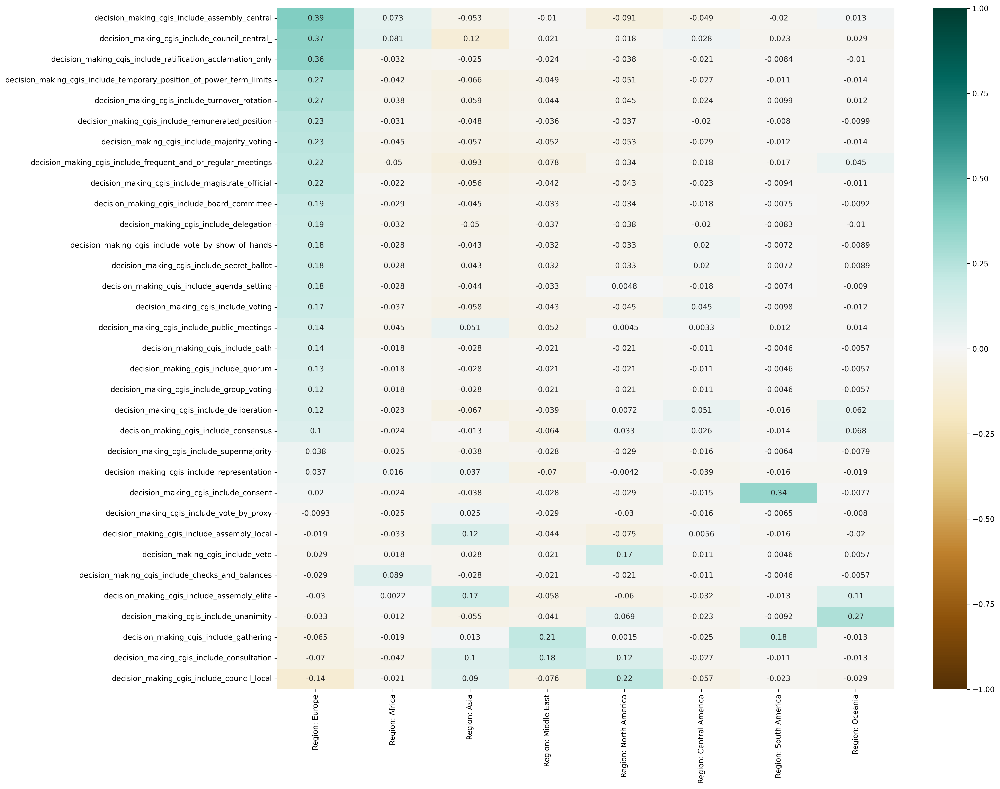

In [67]:
plt.figure(figsize=(20,15))

sns.heatmap(region_decision_making_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_decision_making_cgis.png')
plt.show()

In [68]:
region_enforcement_cgis = region_cgis.loc[enforcement_cgis]

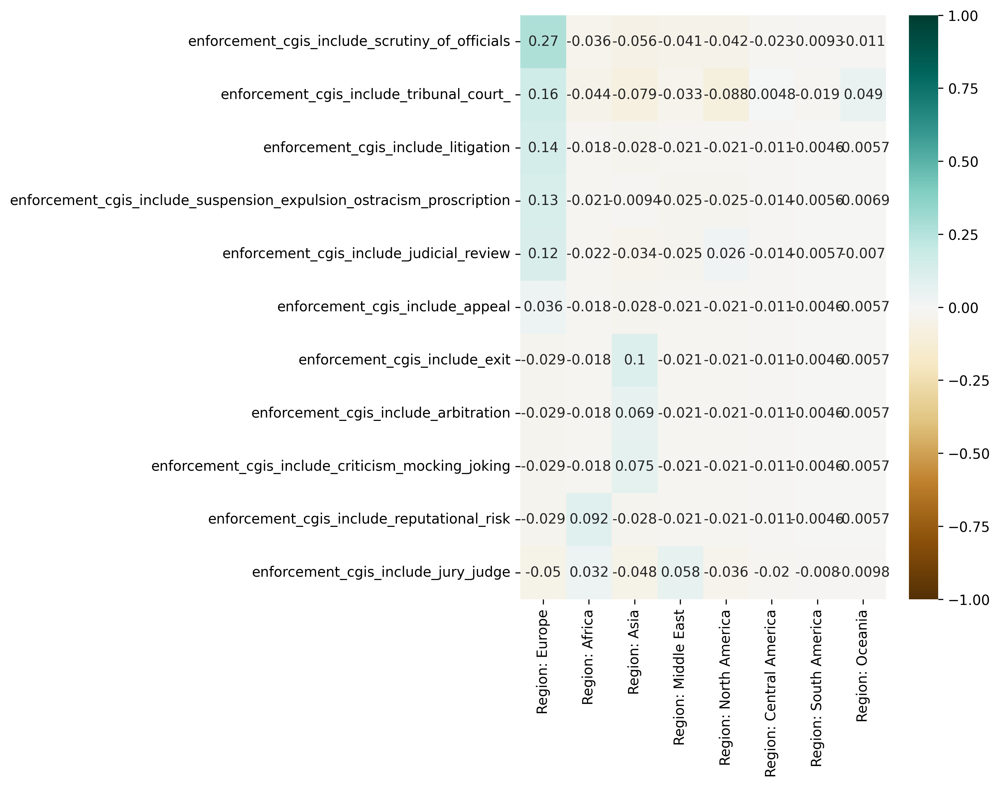

In [69]:
plt.figure(figsize=(10,8))

sns.heatmap(region_enforcement_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'region_enforcement_cgis.png')
plt.show()

## Size x CGIs

In [70]:
size_cgis = query_cgis_df[size_cols]

In [71]:
plt.figure(figsize=(20,15))

sns.heatmap(size_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'cgis_size.png')
plt.show()

### Size x CGIs: Access, Decision Making, Enforcement

In [72]:
size_access_cgis = size_cgis.loc[access_cgis]

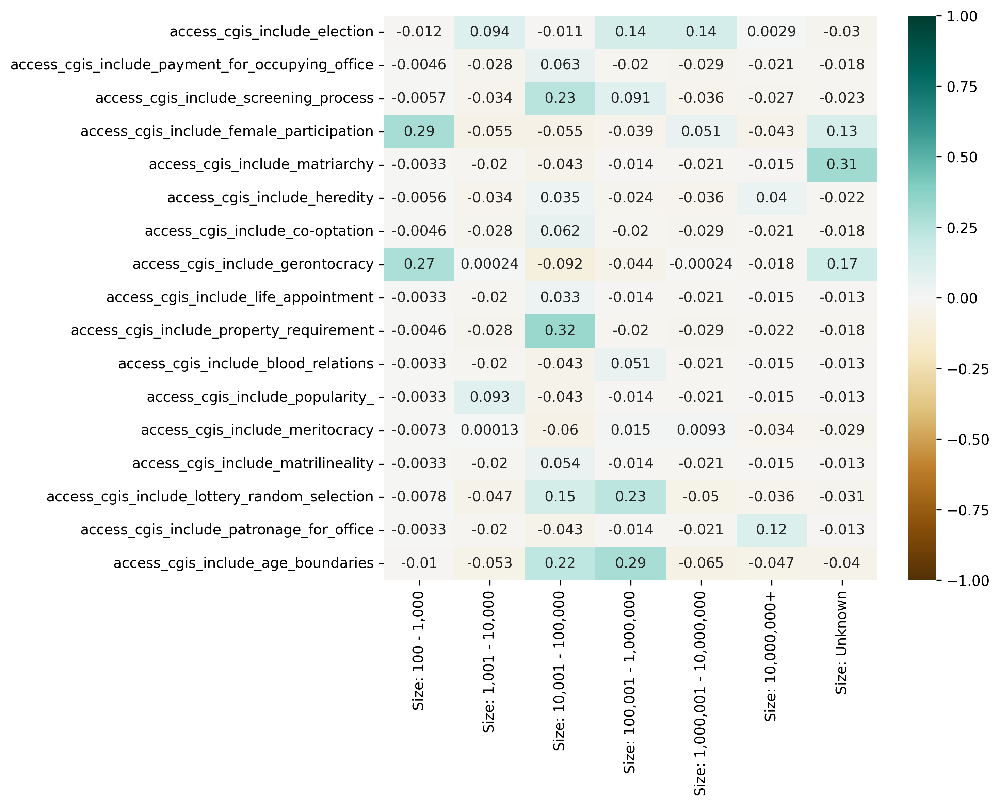

In [73]:
plt.figure(figsize=(10,8))

sns.heatmap(size_access_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_access_cgis.png')
plt.show()

In [74]:
size_decision_making_cgis = size_cgis.loc[decision_making_cgis]

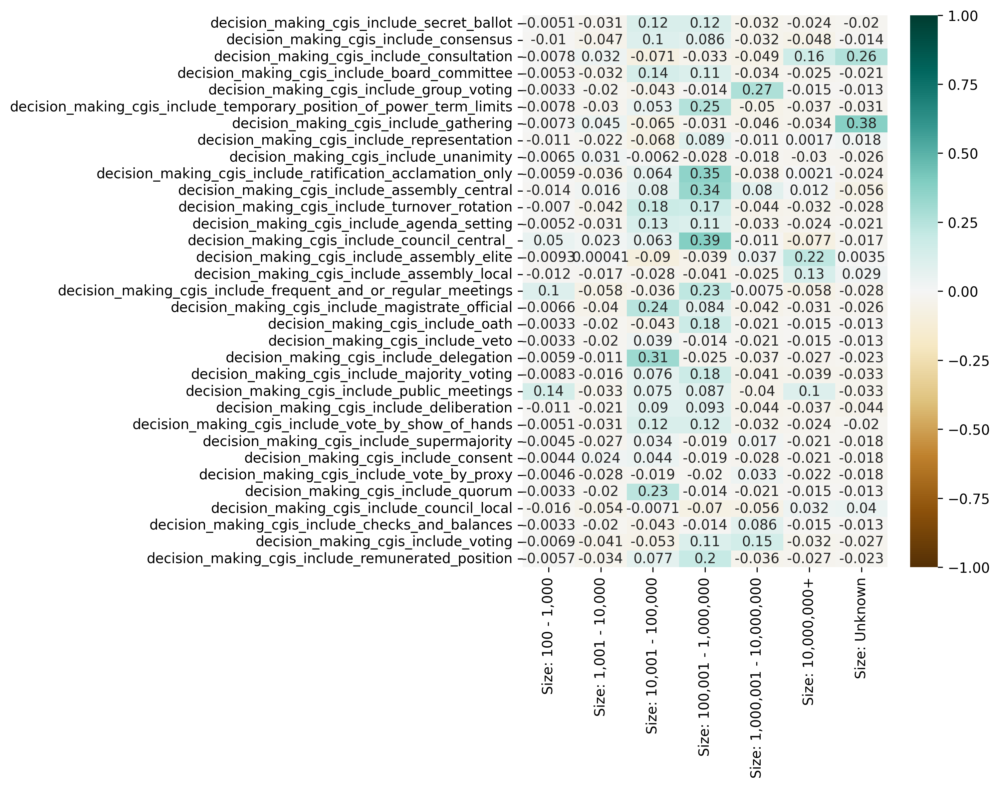

In [75]:
plt.figure(figsize=(10,8))

sns.heatmap(size_decision_making_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_decision_making_cgis.png')
plt.show()

In [76]:
size_enforcement_cgis = size_cgis.loc[enforcement_cgis]

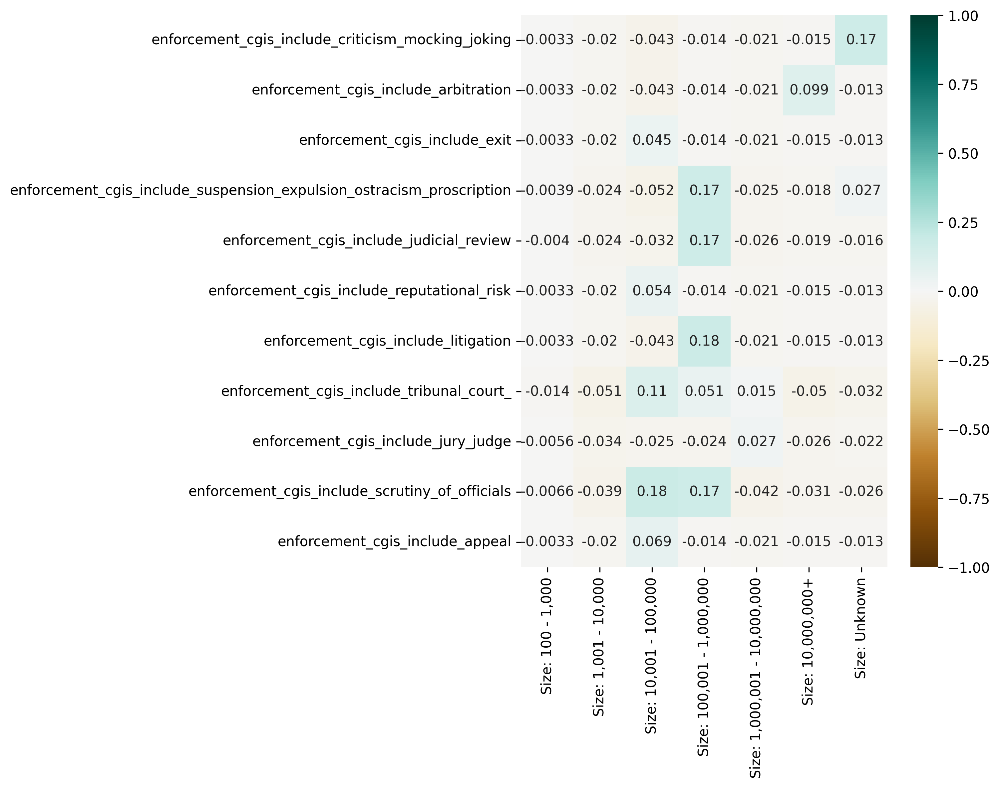

In [77]:
plt.figure(figsize=(10,8))

sns.heatmap(size_enforcement_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.tight_layout()
plt.savefig(fig_dir + 'size_enforcement_cgis.png')
plt.show()

# Sorted positive and negative correlations

In [78]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [79]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [80]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

decision_making_mechanisms_include_lobbying         decision_making_mechanisms_include_word_of_mouth       1.0
enforcement_mechanisms_include_seizing_of_property  decision_making_mechanisms_include_plurality_voting    1.0
enforcement_mechanisms_include_graduated_sanctions  Size: 100 - 1,000                                      1.0
decision_making_mechanisms_include_mandate          Geography: Middle East, Mesopotamia, Babylonia         1.0
enforcement_cgis_include_reputational_risk          access_cgis_include_matrilineality                     1.0
                                                                                                          ... 
Geography: Africa South                             access_cgis_include_lottery_random_selection           NaN
                                                    enforcement_cgis_include_appeal                        NaN
                                                    access_cgis_include_patronage_for_office               NaN
 

In [81]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/v2/cgis_all_correlations.csv')

In [82]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: End           Region: Middle East                                      -0.534063
Time span: Start         decision_making_mechanisms_include_assembly_central      -0.517556
Time span: End           Geography: Middle East                                   -0.508490
Time span: Start         decision_making_mechanisms_include_magistrate_official   -0.502541
                         Time span: Duration                                      -0.497734
                                                                                     ...   
Geography: Africa South  access_cgis_include_lottery_random_selection                   NaN
                         enforcement_cgis_include_appeal                                NaN
                         access_cgis_include_patronage_for_office                       NaN
                         decision_making_cgis_include_remunerated_position              NaN
                         access_cgis_include_age_boundaries                     

In [83]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/v2/cgis_negative_correlations.csv')